In [24]:
# Load basic functions
from scipy.signal import hilbert, butter, filtfilt, cwt, morlet2, welch, freqs, sosfilt
from scipy.fftpack import fft,fftfreq,rfft,irfft,ifft
import numpy as np
import seaborn as sns
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import matplotlib as mpl
import h5py

In [2]:
#Dans Files on met l'ensemble des données des 7 expériences
#Dans Datasets on mets l'ensemble des données d'acquisitions (ECG, EDA, Respiration Rate et Acceleration)
Files = []
Datasets = []
for i in range(1,8):
    if i==1:
        Files.append(h5py.File('./Correlation_stress_datasets/1st_stress.h5', 'r'))
    elif i==2:
        Files.append(h5py.File('./Correlation_stress_datasets/2nd_stress.h5', 'r'))
    elif i==3:
        Files.append(h5py.File('./Correlation_stress_datasets/3rd_stress.h5', 'r'))
    else:
        Files.append(h5py.File(f'./Correlation_stress_datasets/{i}th_stress.h5', 'r'))
for el in Files:
    Datasets.append(el['00:07:80:0F:80:1A']['raw'])

#Le header du fichier 1st_stress.h5 qui donnne des informations supplémentaires
h1 = {"00:07:80:0F:80:1A": {"position": 0, "device": "biosignalsplux", "device name": "00:07:80:0F:80:1A", "device connection": "/dev/tty.biosignalsplux-Bluetoot", "sampling rate": 1000, "resolution": [16, 16, 16, 16], "firmware version": 775, "comments": "", "keywords": "", "mode": 0, "sync interval": 2, "date": "2020-12-14", "time": "12:53:59.523", "channels": [1, 2, 3, 4], "sensor": ["EGG", "EDA", "RESPIRATION", "XYZ"], "label": ["CH1", "CH2", "CH3", "CH4"], "column": ["nSeq", "DI", "CH1", "CH2", "CH3", "CH4"], "special": [{"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}, {"SpO2": [80, 40, 5, 4, 3, 3]}], "digital IO": [0, 1], "sleeve color": ["", "", "", ""]}}

In [3]:
#Fonction qui récupère les données ECG, EDA, RR et ACC de Dataset afin de les plots dans la deuxième fonction. 
#Le paramètre nous sert à définir la taille des données que l'on veut
import matplotlib.pyplot as plt

def collectData(i):
    data_ecg, data_eda, data_rr, data_acc = [], [],[],[]
    for j in range(len(Datasets)):
        data_ecg.append(Datasets[j]['channel_1'][:i])
        data_eda.append(Datasets[j]['channel_2'][:i])
        data_rr.append(Datasets[j]['channel_3'][:i])
        data_acc.append(Datasets[j]['channel_4'][:i])
    return [data_ecg, data_eda, data_rr, data_acc]

allData = np.array(collectData(-1))


In [18]:
def displayChannels(data_, save_name='raw', label=['raw ECG', 'raw EDA', 'raw RR', 'raw ACC'], save=True):
    Fs = 1000
    n = len(data_)
    fig = plt.figure(figsize=(30,5*n), facecolor="white")
    for i in range(n):
        plt.subplot(n,1,i+1)
        plt.plot(data_[i])
        fig.tight_layout()
        plt.title(f'{label[i]} Acquisition')
        plt.xlabel('Acquistition')
        plt.ylabel(f'{label[i]} Value')
        plt.legend()
    if save:
        plt.savefig('imgGuillaumeS/graph_{}.png'.format(save_name))

# Clean data

In [35]:
N = 330599 # number of samples
T = 1.0 / 1000.0 # sample spacing
fs = 1000
x = np.linspace(0.0, N*T, N)

In [5]:
# Labels Audrei
st = 17
bl = 78
td1 = 95
s1 = 128
td2 = 135
s2 = 171
td3 = 219 #fill in the questionary
rel = 230 #start relax

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


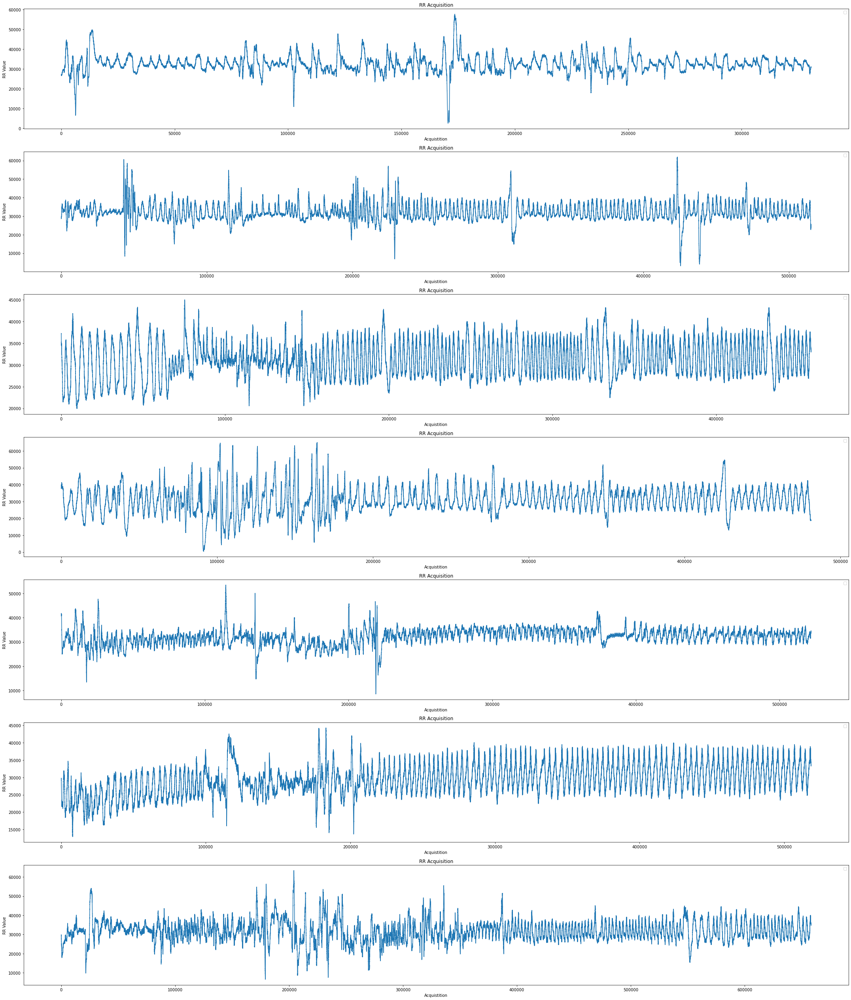

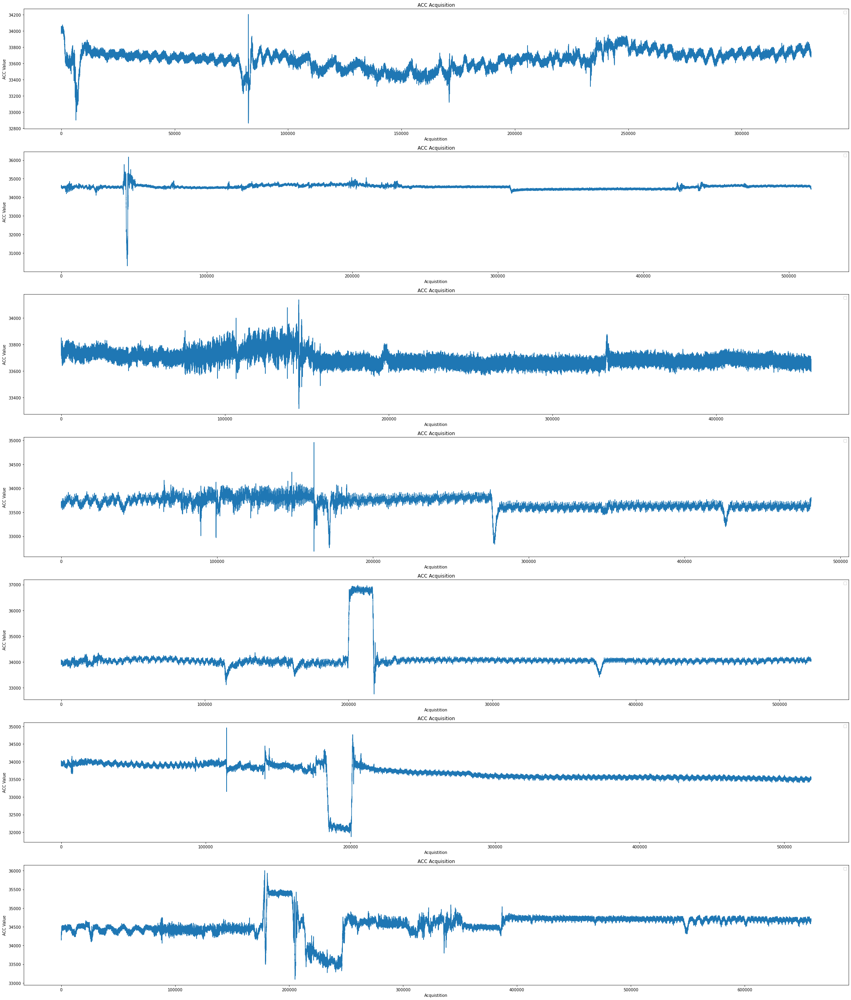

In [7]:
displayChannels(allData[2], save_name='RR raw', label=['RR', 'RR', 'RR', 'RR', 'RR', 'RR', 'RR'])
displayChannels(allData[3], save_name='ACC raw', label=['ACC', 'ACC', 'ACC', 'ACC', 'ACC', 'ACC', 'ACC'])

In [91]:
from sklearn import preprocessing 
#normalization for exp1 and 5 (two interesting and representative exp)
'''
scalingEcg = preprocessing.StandardScaler().fit(allData[0][0].reshape(-1, 1))
scalingEda = preprocessing.StandardScaler().fit(allData[1][0].reshape(-1, 1))
scalingRr = preprocessing.StandardScaler().fit(allData[2][0].reshape(-1, 1))
scalingAcc = preprocessing.StandardScaler().fit(allData[3][0].reshape(-1, 1))

stdDataExp1 = np.array([scalingEcg.fit_transform(allData[0][0].reshape(-1, 1)),
                    scalingEda.fit_transform(allData[1][0].reshape(-1, 1)),
                    scalingRr.fit_transform(allData[2][0].reshape(-1, 1)),
                    scalingAcc.fit_transform(allData[3][0].reshape(-1, 1))])
'''

def stdData(numExp):
    scaling = preprocessing.MinMaxScaler()
    stdDataExpX = np.array([  scaling.fit_transform(allData[0][numExp-1].reshape(-1, 1)),
                        scaling.fit_transform(allData[1][numExp-1].reshape(-1, 1)),
                        scaling.fit_transform(allData[2][numExp-1].reshape(-1, 1)),
                        scaling.fit_transform(allData[3][numExp-1].reshape(-1, 1))])
    return np.squeeze(stdDataExpX)

stdDataExp1 = stdData(1)
stdDataExp2 = stdData(2)
stdDataExp5 = stdData(5)

## filtering

In [103]:
def filterLP2windows(sig, fCutoff, fOrder, window1, window2, saveName):

    rows = 1 + len(fOrder)

    fig = plt.figure(figsize=(20, 10))
    plt.subplot(rows, 2, 1)
    plt.plot(x[window1[0]:window1[1]], sig[window1[0]:window1[1]])
    plt.title('ACC std signal / common')
    plt.subplot(rows, 2, 2)
    plt.plot(x[window2[0]:window2[1]], sig[window2[0]:window2[1]])
    plt.title('ACC std signal / artefact')


    k = 3
    for n in fOrder:
        plt.subplot(rows, 2, k)
        k += 1
        plt.title(f'{n} order lowpass')
        for f in fCutoff: 
            sos = butter(n, f, 'lowpass', fs=1000, output='sos')
            filtered = sosfilt(sos, sig)
            labelStrg = f'fCutoff {f}'
            plt.plot(x[window1[0]:window1[1]], filtered[window1[0]:window1[1]], label=labelStrg)
        plt.subplot(rows, 2, k)
        k += 1
        plt.title(f'{n} order lowpass')
        for f in fCutoff: 
            sos = butter(n, f, 'lowpass', fs=1000, output='sos')
            filtered = sosfilt(sos, sig)
            labelStrg = f'fCutoff {f}'
            plt.plot(x[window2[0]:window2[1]], filtered[window2[0]:window2[1]], label=labelStrg)

    plt.legend()
    plt.xlabel('Time (s)')
    plt.tight_layout()
    plt.savefig(f'imgGuillaumeS/graph_{saveName}.png')
    plt.show()

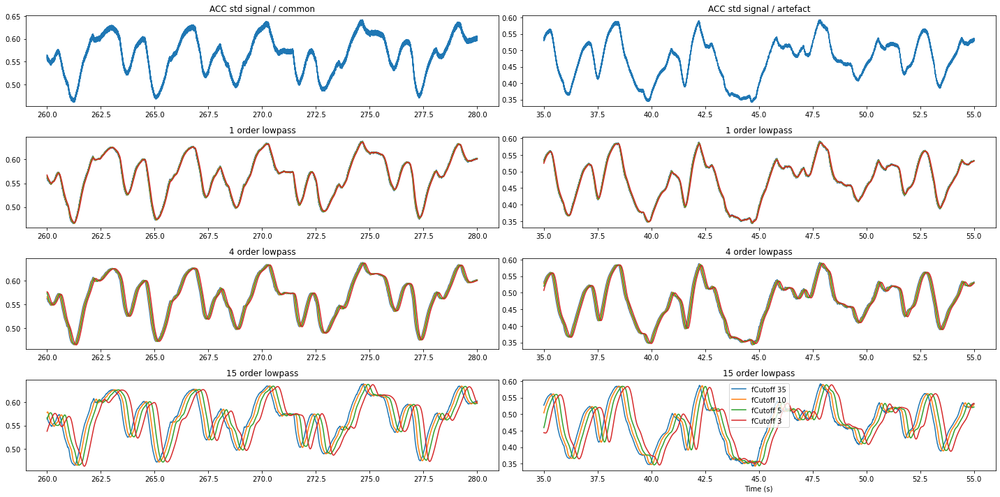

In [107]:
# FILTERING RR

sig = stdDataExp5[2]
w1 = (260*fs, 280*fs) #stable state
w2 = (35*fs, 55*fs) #artefact
fC = [35, 10, 5, 3]
fO = [1, 4, 15]
filterLP2windows(sig, fC, fO, w1, w2, 'rr_filtering1_exp2')

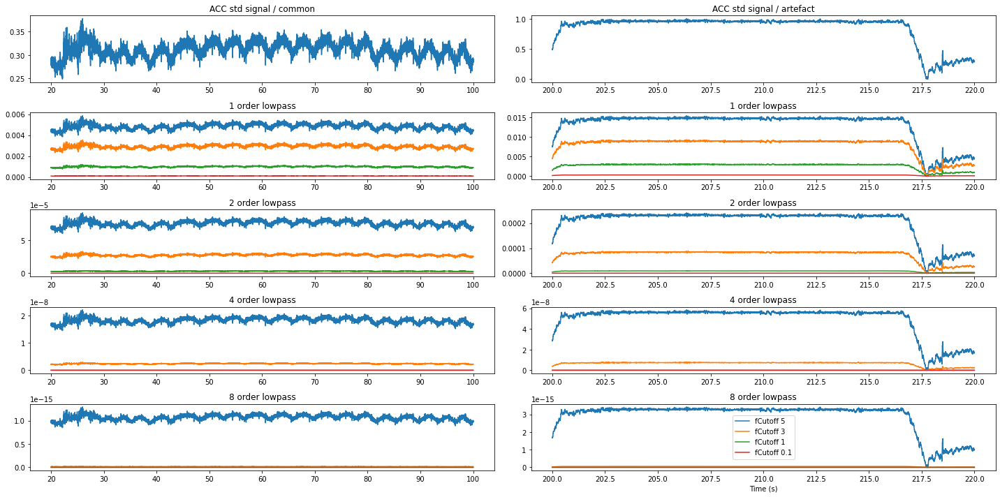

In [89]:
# FILTERING ACC

sig = stdDataExp1[3]
w1 = (20*fs, 100*fs) #stable state
w2 = (200*fs, 220*fs) #artefact
fC = [5, 3, 1, .1]
fO = [1, 2, 4, 8]
filterLP2windows(sig, fC, fO, w1, w2, 'acc_filtering_confirm_exp5')

ACC: After these observations, we choose 3hz lp 4 for the acc signal exp1
- enough noise reduction
- atefact removed

==> confirm on other exp:
border artefact doesnt vanish with the lowering of the cut off frequency - osef
let's keep those settings
same for RR

## Wavelet transform on rr exp1

In [12]:
sig1 = stdDataExp1[2]
sig2 = stdDataExp1[3]
t = np.arange(len(sig1)) / fs
freq = freq = np.linspace(1, fs/2, 100)
w = 10.
widths = w*fs / (2*freq*np.pi)
cwtm1 = cwt(sig1, morlet2, widths, w=w) #continous wavelet transform
cwtm2 = cwt(sig2, morlet2, widths, w=w)
spectrogram1 = np.abs(cwtm1)
spectrogram2 = np.abs(cwtm2)
#spectrogram = spectrogram[:10, :]

plt.figure(facecolor='white', figsize=(30,10))
plt.subplot(2,1,1)
plt.title('CWT RR Exp1')
plt.imshow(spectrogram1, cmap='viridis', origin='lower', aspect='auto', extent=[t[0], t[-1], freq[0], freq[-1]],
           interpolation='bicubic')
plt.xlabel('Time (sec)')
plt.ylabel('Freq (Hz)')
plt.tick_params(axis='both', which='major')
plt.ylim(0,20)

plt.axvline(x=st, color="black", linestyle="--")
plt.axvline(x=bl, color="green", linestyle="--")
plt.axvline(x=td1, color="red", linestyle="--")
plt.axvline(x=s1, color="blue", linestyle="--")
plt.axvline(x=td2, color="blue", linestyle="--")
plt.axvline(x=s2, color="red", linestyle="--")
plt.axvline(x=td3, color="green", linestyle="--")
plt.axvline(x=rel, color="black", linestyle="--")

plt.subplot(2,1,2)
plt.title('CWT ACC Exp1')
plt.imshow(spectrogram2, cmap='viridis', origin='lower', aspect='auto', extent=[t[0], t[-1], freq[0], freq[-1]],
           interpolation='bicubic')
plt.xlabel('Time (sec)')
plt.ylabel('Freq (Hz)')
plt.tick_params(axis='both', which='major')
plt.ylim(0,20)

plt.axvline(x=st, color="black", linestyle="--")
plt.axvline(x=bl, color="green", linestyle="--")
plt.axvline(x=td1, color="red", linestyle="--")
plt.axvline(x=s1, color="blue", linestyle="--")
plt.axvline(x=td2, color="blue", linestyle="--")
plt.axvline(x=s2, color="red", linestyle="--")
plt.axvline(x=td3, color="green", linestyle="--")
plt.axvline(x=rel, color="black", linestyle="--")

plt.show()
plt.savefig('imgGuillaumeS/graph_cwt_rr_acc.png')

KeyboardInterrupt: 

# Following jinhyuncheong
http://jinhyuncheong.com/jekyll/update/2017/12/10/Timeseries_synchrony_tutorial_and_simulations.html

## fft

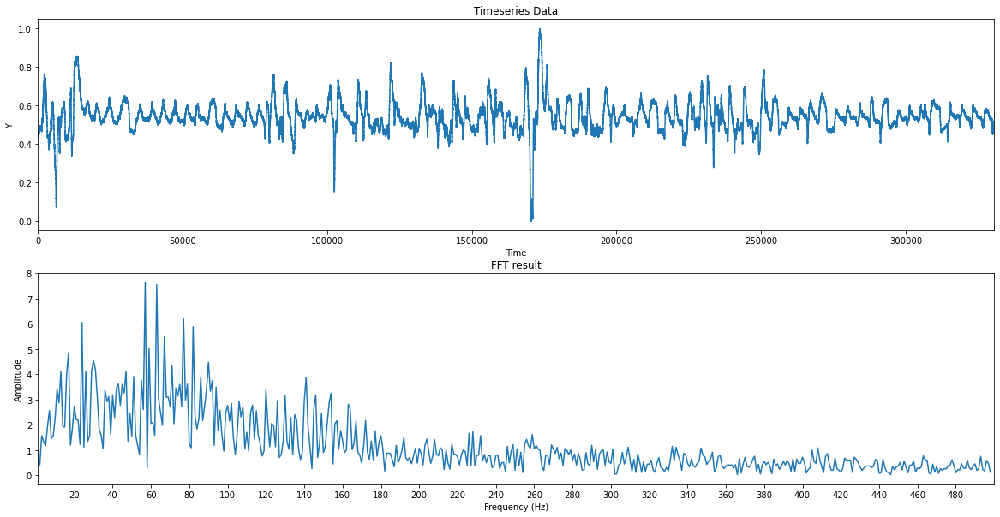

In [18]:
y1 = stdDataExp1[2] # data rr exp1 1D

f,ax=plt.subplots(2,1,figsize=(20,10))
# plot timeseries
ax[0].plot(y1)
ax[0].set(ylabel='Y',xlabel='Time',title='Timeseries Data',xlim=[0,N])
# Plot fft
ticksteps = 20
yf = fft(y1) # perform FFT
amp = np.abs(yf)/500
ax[1].plot(amp[1:500])
ax[1].set(xticks=(np.arange(0,500,ticksteps)), ylabel='Amplitude',xlabel='Frequency (Hz)',title='FFT result',xlim=[1,500])
#ax[1].set_xticklabels(np.round(fftfreq(N,T)[:N//2],2)[::ticksteps],rotation=0)
plt.show()

## phase synchony

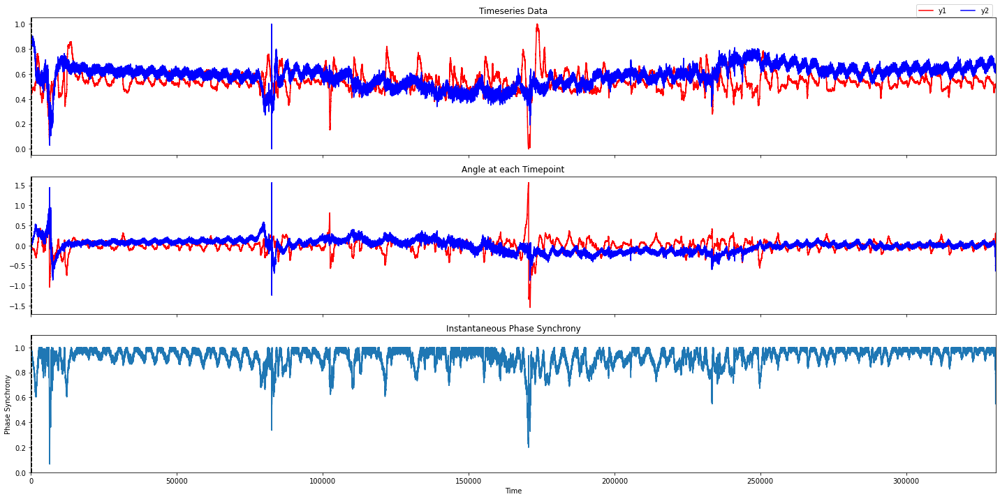

In [9]:
y1 = stdDataExp1[2].tolist() # data rr exp1
y2 = stdDataExp1[3].tolist() # data acc

window=10
al1 = np.angle(hilbert(y1),deg=False)
al2 = np.angle(hilbert(y2),deg=False)
f,ax = plt.subplots(3,1,figsize=(20,10),sharex=True)
ax[0].plot(y1,color='r',label='y1')
ax[0].plot(y2,color='b',label='y2')

ax[0].axvline(x=st, color="black", linestyle="--")
ax[0].axvline(x=bl, color="green", linestyle="--")
ax[0].axvline(x=td1, color="red", linestyle="--")
ax[0].axvline(x=s1, color="blue", linestyle="--")
ax[0].axvline(x=td2, color="blue", linestyle="--")
ax[0].axvline(x=s2, color="red", linestyle="--")
ax[0].axvline(x=td3, color="green", linestyle="--")
ax[0].axvline(x=rel, color="black", linestyle="--")

ax[0].legend(bbox_to_anchor=(0., 1.02, 1., .102),ncol=2)
ax[0].set(xlim=[0,N], title='Timeseries Data')
ax[1].plot(al1,color='r')
ax[1].plot(al2,color='b')


ax[1].axvline(x=st, color="black", linestyle="--")
ax[1].axvline(x=bl, color="green", linestyle="--")
ax[1].axvline(x=td1, color="red", linestyle="--")
ax[1].axvline(x=s1, color="blue", linestyle="--")
ax[1].axvline(x=td2, color="blue", linestyle="--")
ax[1].axvline(x=s2, color="red", linestyle="--")
ax[1].axvline(x=td3, color="green", linestyle="--")
ax[1].axvline(x=rel, color="black", linestyle="--")

ax[1].set(title='Angle at each Timepoint')
phase_synchrony = 1-np.sin(np.abs(al1-al2)/2)
ax[2].plot(phase_synchrony)


ax[2].axvline(x=st, color="black", linestyle="--")
ax[2].axvline(x=bl, color="green", linestyle="--")
ax[2].axvline(x=td1, color="red", linestyle="--")
ax[2].axvline(x=s1, color="blue", linestyle="--")
ax[2].axvline(x=td2, color="blue", linestyle="--")
ax[2].axvline(x=s2, color="red", linestyle="--")
ax[2].axvline(x=td3, color="green", linestyle="--")
ax[2].axvline(x=rel, color="black", linestyle="--")

ax[2].set(ylim=[0,1.1],xlim=[0,N],title='Instantaneous Phase Synchrony',xlabel='Time',ylabel='Phase Synchrony')
plt.tight_layout()
plt.show()

In [60]:
def get_triangle(df,k=0):
    '''
    This function grabs the upper triangle of a correlation matrix
    by masking out the bottom triangle (tril) and returns the values.

    df: pandas correlation matrix
    '''
    x = np.hstack(df.mask(np.tril(np.ones(df.shape),k=k).astype(np.bool)).values.tolist())
    x = x[~np.isnan(x)]
    return x  
    
def rolling_correlation(data, wrap=False, *args, **kwargs):
    '''
    Intersubject rolling correlation.
    Data is dataframe with observations in rows, subjects in columns.
    Calculates pairwise rolling correlation at each time.
    Grabs the upper triangle, at each timepoints returns dataframe with
    observation in rows and pairs of subjects in columns.
    *args:
        window: window size of rolling corr in samples
        center: whether to center result (Default: False, so correlation values are listed on the right.)
    '''
    data_len = data.shape[0]
    half_data_len = int(data.shape[0]/2)
    start_len = data.iloc[half_data_len:].shape[0]
    if wrap:
        data = pd.concat([data.iloc[half_data_len:],data,data.iloc[:half_data_len]],axis=0).reset_index(drop=True)
    _rolling = data.rolling(*args, **kwargs).corr()       
    rs=[]
    for i in np.arange(0,data.shape[0]):
        rs.append(get_triangle(_rolling.loc[i]))
    rs = pd.DataFrame(rs)   
    rs = rs.iloc[start_len:start_len+data_len].reset_index(drop=True)
    return rs  

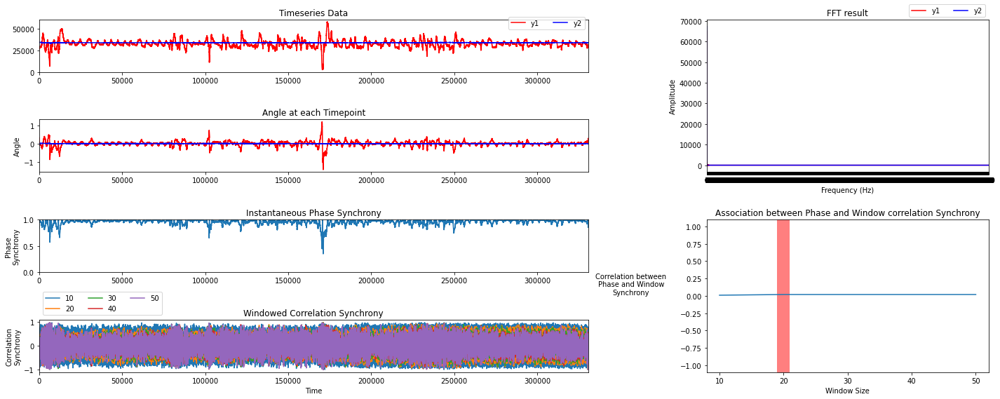

In [67]:

window_sizes = [10,20,30,40,50]
window_sizes = np.arange(10,51,10).astype(int)


y1 = stdDataExp1[2]
y2 = stdDataExp1[3]

al1 = np.angle(hilbert(y1),deg=False)
al2 = np.angle(hilbert(y2),deg=False)
f = plt.figure(figsize=(20,8))
gs = mpl.gridspec.GridSpec(4,8)
ax=[f.add_subplot(gs[0,:5]), f.add_subplot(gs[1,:5]),
    f.add_subplot(gs[2,:5]),f.add_subplot(gs[3,:5]),
    f.add_subplot(gs[:2,5:]), f.add_subplot(gs[2:,5:])]
ax[0].plot(y1,color='r',label='rr')
ax[0].plot(y2,color='b',label='acc')
ax[0].legend(bbox_to_anchor=(0., 1.02, 1., .102),ncol=2)
ax[0].set(xlim=[0,N], title='Timeseries Data')
ax[1].plot(al1,color='r')
ax[1].plot(al2,color='b')
ax[1].set(ylabel='Angle', xlim=[0,N],title='Angle at each Timepoint')
phase_synchrony = 1-np.sin(np.abs(al1-al2)/2)
ax[2].plot(phase_synchrony)
ax[2].set(ylim=[0,1],xlim=[0,N],title='Instantaneous Phase Synchrony',ylabel='Phase\nSynchrony')
window_corr_synchrony = pd.DataFrame(columns=window_sizes,index=np.arange(0,N))
for window_size in window_sizes:
    window_corr_synchrony[window_size]=rolling_correlation(data=pd.DataFrame({'y1':y1,'y2':y2}),wrap=True,window=window_size,center=True)
window_corr_synchrony.plot(ax=ax[3])
ax[3].legend(bbox_to_anchor=(0., 1.02, 1., .102),ncol=3)
ax[3].set(ylim=[-1.1,1.1],xlim=[0,N],title='Windowed Correlation Synchrony',xlabel='Time',ylabel='Correlation\nSynchrony')

ticksteps = 30
yf1,yf2 = fft(y1),fft(y2) # perform FFT
amp1,amp2 = 2.0/N * np.abs(yf1),2.0/N * np.abs(yf2)
ax[4].plot(amp1[:N//2],color='r',label='rr')
ax[4].plot(amp2[:N//2],color='b',label='acc')
ax[4].set(xticks=(np.arange(0,N//2,ticksteps)), ylabel='Amplitude',xlabel='Frequency (Hz)',title='FFT result',xlim=[0,N//2])
ax[4].set_xticklabels([int(_tick) for _tick in np.round(fftfreq(N,T)[:N//2],2)[::ticksteps]],rotation=0)
ax[4].legend(bbox_to_anchor=(0., 1.02, 1., .102),ncol=3)

rs_per_window = pd.DataFrame(columns=['rs'],index=np.arange(min(window_sizes),max(window_sizes)+1,1))
rs_per_window['rs']=np.nan
for window_size in window_sizes:
    rs_per_window.loc[window_size,'rs'] = (np.round(stats.pearsonr(phase_synchrony,window_corr_synchrony[window_size].values.ravel())[0],2))
rs_per_window.interpolate(method='index').plot(ax=ax[5],legend=False)
ax[5].set(xticks=window_sizes,xticklabels=[int(w) for w in window_sizes],ylim=[-1.1,1.1],xlabel='Window Size',title='Association between Phase and Window correlation Synchrony')
ax[5].set_ylabel('Correlation between\nPhase and Window\nSynchrony',rotation=0,labelpad=70)
rs_bool = rs_per_window==rs_per_window.max()
rs_bool.loc[rs_per_window.idxmax().values[0]-1:rs_per_window.idxmax().values[0]+1]=True
ax[5].fill_between(np.arange(min(window_sizes),max(window_sizes)+1,1),-1.1,1.1,where=rs_bool.values.ravel(),facecolor='red',alpha=.5)
plt.tight_layout()
plt.show()